# Hierarchical models with mixed centered and non-centered parameterizations

## Background

In his post on [hierarchical models](https://betanalpha.github.io/assets/case_studies/hierarchical_modeling.html), Michael Betancourt goes in-depth on the *funnel pathologies* that often plague hierarchical modeling. My goal here is to reproduce his analysis in PyMC3 and explore these problems and their solutions.

A hierarchical model is one that simultaneously models data from individual distributions and a population distribution.
More specifically, the parameters for the individual distributions come from a shared population distribution.
With this structure, each individual distribution is shaped by its data points, but also the population distribution, a technique referred to as *partial pooling* of information.

However, the sampling of the posteriors of these models can have issues (described in Betancourt's post) that lead to poor model fitting.
In general, with weakly-informative likelihoods in the individual distributions, centered parameterizations demonstrate strong funnel geometries that can be fixed with a non-centered parameterization.
Alternatively, when the individual distributions are narrow (i.e. highly-informative), the centered parameterization is superior to the non-centered parameterization (though the funnel degeneracy is somewhat mitigated by partial pooling of information).
Importantly, these general conclusions are only in reference to "uniformly-informative" individual likelihoods – not when some individuals have a lot more data than others.
For this case, Betancourt [creates a model](https://betanalpha.github.io/assets/case_studies/hierarchical_modeling.html#423_Unbalanced_Likelihood_Functions) with a mixture of centered parameterizations for the weakly-informed cases and non-centered parameterizations for strongly-informed cases.

Below is the Stan model that Betancourt creates followed by the diagram he included to explain its structure:

```text
data {
  int<lower=0> N;      // Number of observations
  vector[N] y;         // Observations
  real<lower=0> sigma; // Measurement variability
  
  // Number of individual contexts in hierarchy
  int<lower=0> K;
  // Individual context from which each observation is generated
  int<lower=1, upper=K> indiv_idx[N]; 
  
  int<lower=0, upper=K> K_ncp;          // Number of noncentered individuals
  int<lower=1, upper=K> ncp_idx[K_ncp]; // Index of noncentered individuals
  
  int<lower=0, upper=K> K_cp;           // Number of centered individuals
  int<lower=1, upper=K> cp_idx[K_cp];   // Index of noncentered individuals
}

parameters {
  real mu;                  // Population location
  real<lower=0> tau;        // Population scale
  vector[K_ncp] theta_ncp;  // Non-centered individual parameters
  vector[K_cp]  theta_cp;   // Ccentered individual parameters
}

transformed parameters {
  // Recentered individual parameters
  vector[K] theta;
  theta[ncp_idx] = mu + tau * theta_ncp;
  theta[cp_idx] = theta_cp;
}

model {
  mu ~ normal(0, 5);          // Prior model
  tau ~ normal(0, 5);         // Prior model
  
  theta_ncp ~ normal(0, 1);   // Non-centered hierarchical model
  theta_cp ~ normal(mu, tau); // Centered hierarchical model
  
  y ~ normal(theta[indiv_idx], sigma); // Observational model
}
```

---

![](assets/mixed-parameterization-model-diagram.png)

## Analysis

In [1]:
from pprint import pprint
from typing import Any

import arviz as az
import janitor  # noqa: F401
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc3 as pm
import seaborn as sns

In [2]:
sns.set_theme(style="whitegrid")
%matplotlib inline
%config InlineBackend.figure_format = "retina"
RANDOM_SEED = 345890

### Uniformly weakly-informative likelihood functions

The first case we will look at is where all of the individuals are weakly informed and then compare it to when each likelihood is highly-informed.
This can be induced by using less and more data, but Betancourt chose to just adjust the standard deviation $\sigma$ of the likelihood function to control the strength.

The following function mimics the data-generating Stan file that Betancourt uses.

In [3]:
from dataclasses import dataclass


@dataclass
class MockData:
    """Mock data."""

    N: int
    K: int
    sigma: float
    mu: float
    tau: float
    theta: np.ndarray
    idx: np.ndarray
    y: np.ndarray


def generate_data(N: int, K: int, indiv_idx: np.ndarray, sigma: float) -> MockData:
    """Generate data for modeling."""
    # Assertions about the input data.
    assert N >= 1
    assert K >= 0
    assert len(indiv_idx) == N
    assert sigma >= 0

    mu = 4.5
    tau = 3.5
    theta = np.random.normal(mu, tau, size=K).flatten()
    y = np.random.normal(theta[indiv_idx], sigma).flatten()

    return MockData(
        N=N, K=K, sigma=sigma, mu=mu, tau=tau, theta=theta, idx=indiv_idx.copy(), y=y
    )

The first data set we will build will have all of the individuals uniformly weakly-informed by using a large standard deviation $\sigma=10$.

In [4]:
N = 9
K = 9
indiv_idx = np.arange(N)
sigma = 10

np.random.seed(1234)
data = generate_data(N=N, K=K, indiv_idx=indiv_idx, sigma=sigma)
pprint(data)

MockData(N=9, K=9, sigma=10, mu=4.5, tau=3.5, theta=array([6.15002307, 0.33158507, 9.51447439, 3.40571836, 1.97793943,
       7.60507029, 7.50855945, 2.27216773, 4.5549373 ]), idx=array([0, 1, 2, 3, 4, 5, 6, 7, 8]), y=array([-16.27682647,  11.83194232,  19.43393461,  12.93895964,
       -18.23460877,   4.26429663,   7.52974309,   6.32670185,
         7.44585671]))


<AxesSubplot:xlabel='k', ylabel='y'>

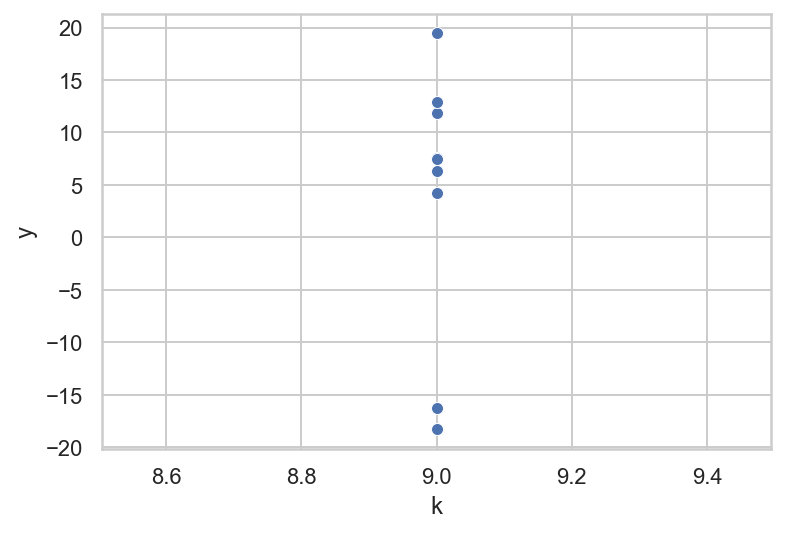

In [5]:
df = pd.DataFrame({"y": data.y, "k": data.K})
sns.scatterplot(data=df, x="k", y="y")

#### Monolithically centered parameterization

The first model we will fit has all of the individual parameters using the centered parameterization.
This is considered the default way to code a hierarchical model.
We expect there to be strong funnel degeneracies because of the weakly-informed individual likelihood functions.

In [6]:
def centered_model(
    d: MockData, draws: int = 10000, tune: int = 1000
) -> tuple[az.InferenceData, dict[str, Any]]:
    with pm.Model():
        mu = pm.Normal("mu", 0, 5)
        tau = pm.HalfNormal("tau", 5)
        theta = pm.Normal("theta", mu, tau, shape=d.K)
        y = pm.Normal("y", theta[d.idx], d.sigma, observed=d.y)

        cp_trace = pm.sample(
            draws=draws,
            tune=tune,
            chains=4,
            cores=4,
            return_inferencedata=True,
            random_seed=RANDOM_SEED,
            target_accept=0.95,
        )
        assert isinstance(cp_trace, az.InferenceData)
        cp_y_post_pred = pm.sample_posterior_predictive(
            trace=cp_trace, random_seed=RANDOM_SEED
        )
    return cp_trace, cp_y_post_pred

In [7]:
cp_trace, cp_y_post_pred = centered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [theta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 133 seconds.
There were 201 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8878940542236412, but should be close to 0.95. Try to increase the number of tuning steps.
There were 204 divergences after tuning. Increase `target_accept` or reparameterize.
There were 223 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8894741140811627, but should be close to 0.95. Try to increase the number of tuning steps.
There were 78 divergences after tuning. Increase `target_accept` or reparameterize.
The acceptance probability does not match the target. It is 0.8939084776763185, but should be close to 0.95. Try to increase the number of tuning steps.
The number of effective samples is smaller than 10% for some parameters.


The Bayesian fraction of missing information (BFMI) is quite low indicating that the sampling process was unable to explore very well.
I do not know the details of MCMC, so I cannot explain this diagnostic any further, but I do know that less than 0.3 is bad.

In [8]:
az.bfmi(cp_trace)

array([0.21946218, 0.18973042, 0.22202245, 0.32011095])

From the following trace plots, we can see that the posterior distributions for the population parameters were uneven, indicating problems with the sampling.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

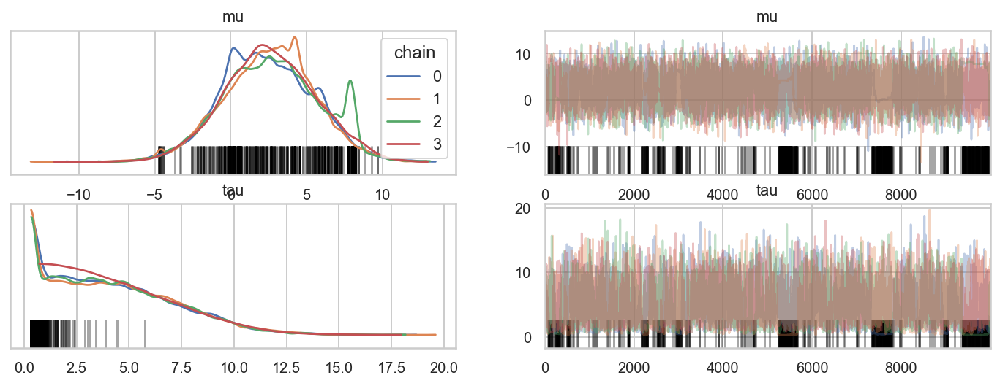

In [9]:
az.plot_trace(cp_trace, ["mu", "tau"], compact=False, combined=False, legend=True)

We can now look for the funnel relationship between the population dispersion parameter $\tau$ and the individual means $\theta$.
The general idea of the funnel geometry is that it shows how the possible values for the individual means shrink as the population variance shrinks.
The MCMC chain has difficulty exploring this region leading to restricted exploration of the region and frequent divergences as it gets closer.

In [10]:
def get_divergences(t: az.InferenceData) -> np.ndarray:
    return t.sample_stats.diverging.values


def get_dispersion_and_individual_posteriors_tidy(
    t: az.InferenceData, disp_var: str, indiv_var: str, n_indiv: int
) -> pd.DataFrame:
    """Get a tidy dataframe of the dispersion posterior and individuals' posteriors.

    Args:
        t (az.InferenceData): Model trace.
        disp_var (str): Name of dispersion variable
        indiv_var (str): Name of the individual variable.
        n_indiv (int): Number of individuals.

    Returns:
        (pd.DataFrame): Tidy pandas dataframe.
    """
    divergences = get_divergences(t).flatten()
    disp_post = t.posterior[disp_var].values.flatten()
    indiv_post = t.posterior[indiv_var].values.reshape(-1, n_indiv)

    return (
        pd.concat(
            [
                pd.DataFrame(
                    {
                        disp_var: disp_post,
                        "is_divergence": divergences,
                        indiv_var: indiv_post[:, i],
                        "indiv_i": i,
                    }
                )
                for i in range(n_indiv)
            ]
        )
        .assign(_log_disp_var=lambda d: np.log(d[disp_var]))
        .rename(columns={"_log_disp_var": f"log_{disp_var}"})
    )

In [11]:
theta_tau_post_df = get_dispersion_and_individual_posteriors_tidy(
    cp_trace, "tau", "theta", data.K
)
theta_tau_post_df.head()

,tau,is_divergence,theta,indiv_i,log_tau
0,3.883579,False,-1.760216,0,1.356757
1,4.732260,False,2.656484,0,1.554403
2,5.507971,False,-0.370168,0,1.706196
3,5.510663,False,-3.233854,0,1.706685
4,5.829565,False,-8.711616,0,1.762942


In [12]:
def plot_funnels(
    post_df: pd.DataFrame, x: str = "theta", y: str = "log_tau", min_y: float = -8
) -> None:
    sns.relplot(
        data=post_df.sort_values("is_divergence"),
        x=x,
        y=y,
        col="indiv_i",
        hue="is_divergence",
        kind="scatter",
        col_wrap=3,
        alpha=0.8,
    )
    plt.ylim(min_y, post_df["log_tau"].max() * 1.02)
    plt.show()
    return None

The plots below show the funnels for each of the individual means with the divergences highlighted in orange.
We can see how MCMC has difficulties exploring the neck of the funnel, often producing divergences when it gets close.

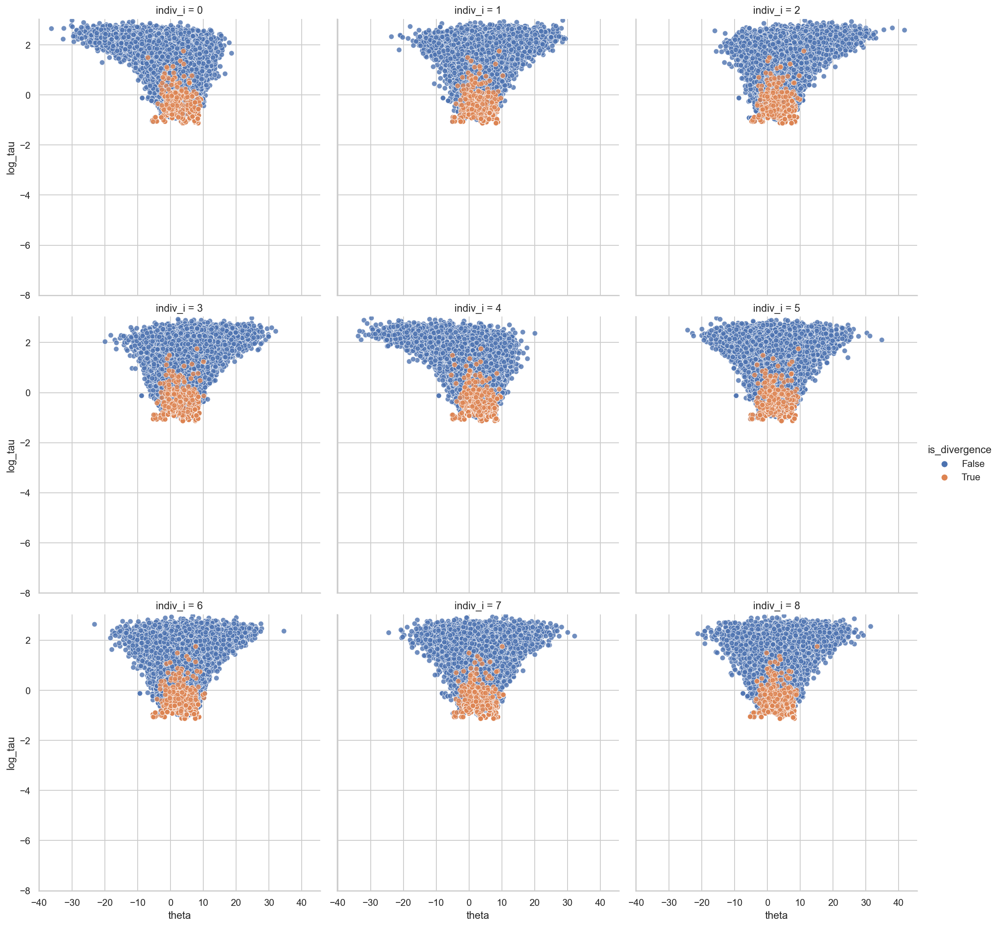

In [13]:
plot_funnels(theta_tau_post_df)

#### Monolithically non-centered parameterization

The following model is a non-centered parametrization of the model.
The non-centered parameterization separates the centrality of the individual contexts from the population parameters.
It turns the focus from finding the absolute location of the individual distribution to the deviation from the population distribution.
Under these circumstances, we expect this parameterization to fix the funnel pathologies and divergences found in the centered parametrization.

In [14]:
def noncentered_model(
    d: MockData, draws: int = 10000, tune: int = 1000
) -> tuple[az.InferenceData, dict[str, np.ndarray]]:
    with pm.Model() as ncp_model:
        mu = pm.Normal("mu", 0, 5)
        tau = pm.HalfNormal("tau", 5)
        eta = pm.Normal("eta", 0, 1, shape=d.K)
        theta = pm.Deterministic("theta", mu + (tau * eta))
        y = pm.Normal("y", theta[d.idx], d.sigma, observed=d.y)

        trace = pm.sample(
            draws=draws,
            tune=tune,
            chains=4,
            cores=4,
            return_inferencedata=True,
            random_seed=RANDOM_SEED,
            target_accept=0.95,
        )
        assert isinstance(trace, az.InferenceData)
        y_post_pred = pm.sample_posterior_predictive(
            trace=trace, random_seed=RANDOM_SEED
        )
    return trace, y_post_pred

In [15]:
ncp_trace, ncp_y_post_pred = noncentered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [eta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 67 seconds.


We can see the BFMI are much better with the non-centered parameterizations.

In [16]:
az.bfmi(cp_trace), az.bfmi(ncp_trace)

(array([0.21946218, 0.18973042, 0.22202245, 0.32011095]),
 array([0.86619064, 0.87219232, 0.90678977, 0.90566707]))

And the posteriors for the global distributions are smoother.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

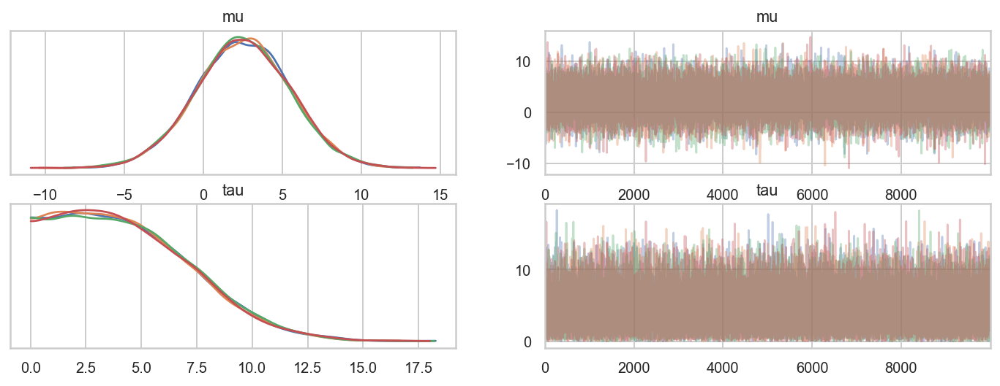

In [17]:
az.plot_trace(ncp_trace, ["mu", "tau"], compact=False, combined=False)

Now, when we look at the relationship between the population dispersion $\tau$ and the individual distributions $\theta$, there are no funnels.

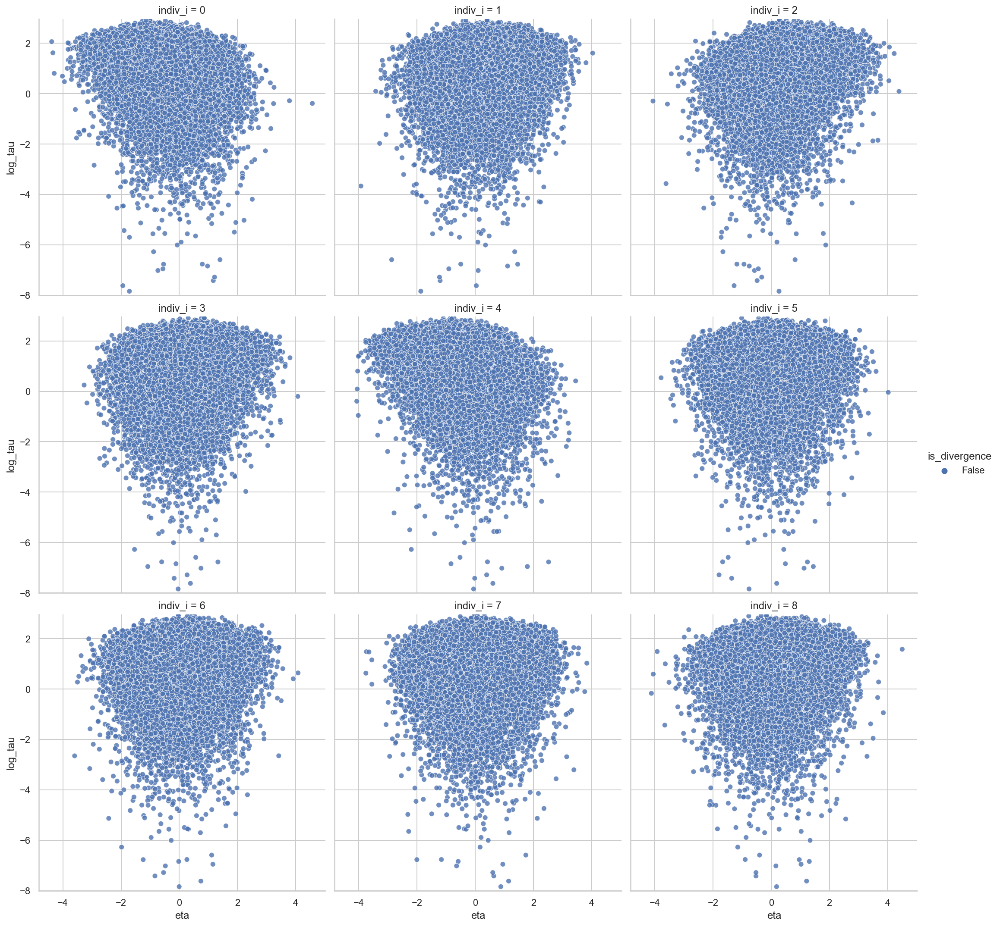

In [18]:
eta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "eta", data.K
)
theta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "theta", data.K
)

plot_funnels(eta_tau_post_df_ncp, x="eta", min_y=-8)

In [19]:
def plot_overlapping_funnels(
    centered_post: pd.DataFrame, noncentered_post: pd.DataFrame, min_y: float = -8
) -> None:
    sns.relplot(
        data=pd.concat(
            [
                noncentered_post.assign(model="non-centered"),
                centered_post.assign(model="centered"),
            ]
        ),
        x="theta",
        y="log_tau",
        col="indiv_i",
        hue="model",
        kind="scatter",
        alpha=0.3,
        col_wrap=3,
        palette={"centered": "b", "non-centered": "r"},
    )
    plt.ylim(min_y, noncentered_post["log_tau"].max() * 1.02)
    plt.show()

This leads to a better exploration of smaller values for the population dispersion $\tau$ in the non-centered parameterization (red) than the centered parameterization (blue).

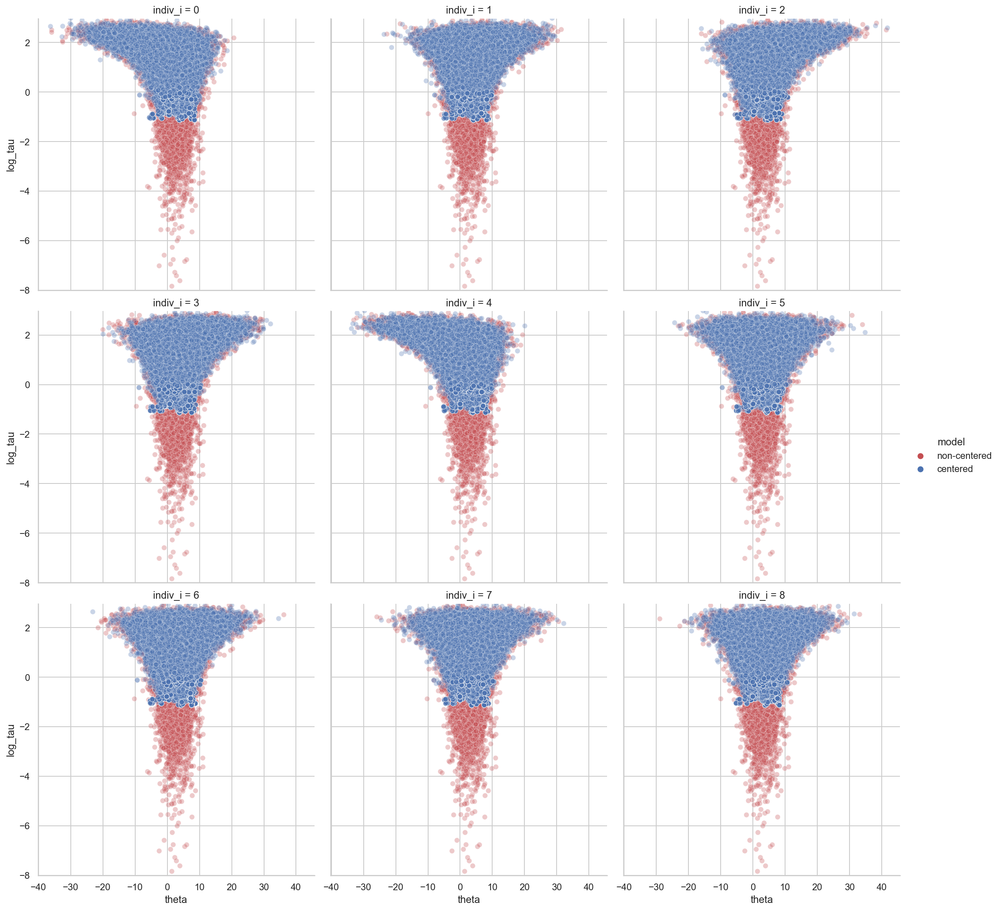

In [20]:
plot_overlapping_funnels(theta_tau_post_df, theta_tau_post_df_ncp)

In [21]:
def plot_prior_against_tau_post(
    cp_trace: az.InferenceData,
    ncp_trace: az.InferenceData,
    real_tau: float,
    tau_prior_sd: float = 5,
) -> None:
    tau_post = (
        pd.DataFrame(
            {
                "centered": cp_trace.posterior["tau"].values.flatten(),
                "non-centered": ncp_trace.posterior["tau"].values.flatten(),
                "prior": np.abs(
                    np.random.normal(
                        0,
                        tau_prior_sd,
                        ncp_trace.posterior["tau"].values.flatten().shape[0],
                    )
                ),
            }
        )
        .reset_index(drop=False)
        .pivot_longer(
            index="index",
            column_names=["centered", "non-centered", "prior"],
            names_to="model",
            values_to="tau",
        )
    )

    sns.histplot(
        data=tau_post,
        x="tau",
        hue="model",
        palette={"centered": "b", "non-centered": "r", "prior": "k"},
    )
    plt.xlim(0, tau_post.tau.max() * 1.02)
    plt.axvline(real_tau, color="k", linestyle="--")
    plt.show()

We can see the impact on the posterior distribution of $\tau$ in the plot below below; pay particular attention to the near-zero values.

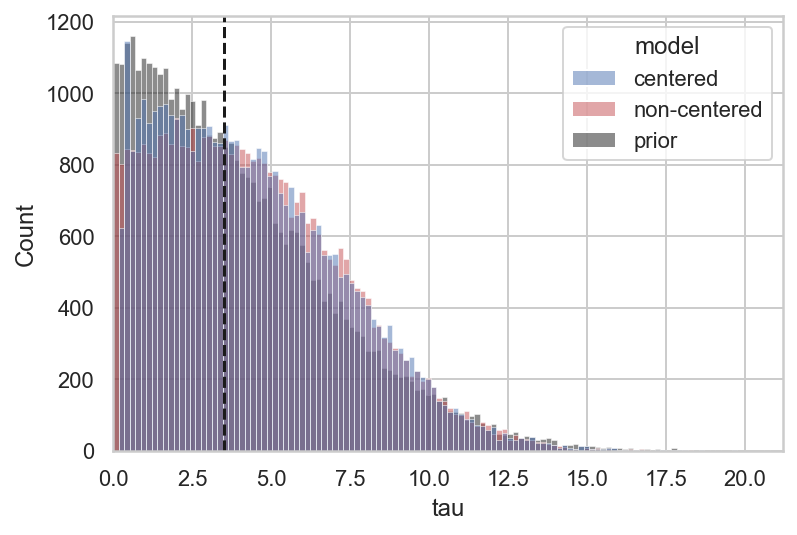

In [22]:
plot_prior_against_tau_post(cp_trace, ncp_trace, data.tau)

In [23]:
def plot_comparison_ppc(
    cp_ppc: dict[str, Any], ncp_ppc: dict[str, Any], data: MockData
) -> None:
    ppc_df = pd.DataFrame()

    for ppc, model in zip([ncp_ppc, cp_ppc], ["non-centered", "centered"]):
        df = pd.DataFrame(ppc["y"])
        df.columns = [f"y{i}" for i in df.columns]
        df = (
            df.reset_index()
            .pivot_longer(index="index", names_to="y", values_to="value")
            .assign(model=model)
        )
        ppc_df = pd.concat([ppc_df, df])

    data_df = pd.DataFrame({"y": [f"y{i}" for i in range(data.K)], "value": data.y})

    ax = sns.violinplot(
        data=ppc_df,
        x="y",
        y="value",
        hue="model",
        split=True,
        inner="quart",
        linewidth=1,
        palette={"centered": "b", "non-centered": "r"},
    )
    ax = sns.scatterplot(data=data_df, x="y", y="value", ax=ax, color="g", s=50)
    plt.ylim(ppc_df.value.min(), ppc_df.value.max())
    plt.show()

Notably, the posterior predictions each data point in the two models are very simillar.
The differences are primarily in the parameter estimates.

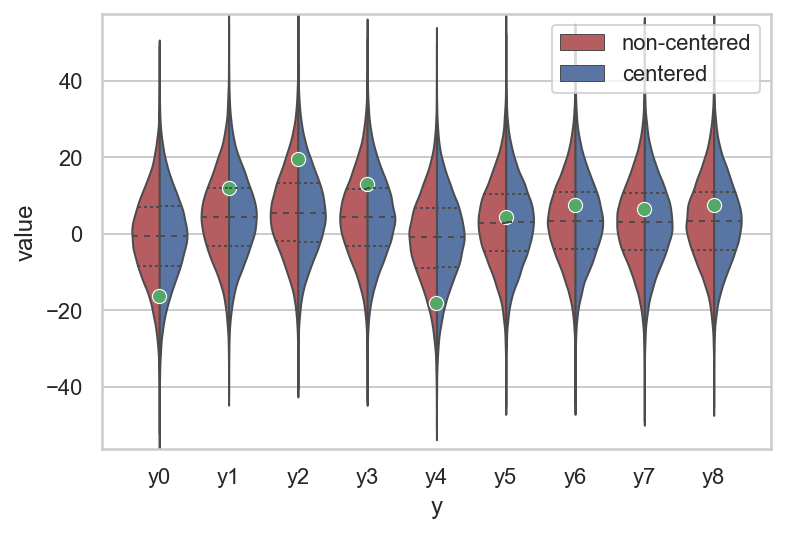

In [24]:
plot_comparison_ppc(cp_y_post_pred, ncp_y_post_pred, data)

### Uniformly strongly-informative likelihood functions 

Now we will look at a case where there individual likelihoods are close enough to dominate the structure of the posterior density function.
This mimics the case where the individual distributions are well-informed.
The data will now be generated with a smaller standard deviation, $\sigma = 0.1$.

In [25]:
np.random.seed(1235)
data = generate_data(N=N, K=K, indiv_idx=indiv_idx, sigma=0.1)
pprint(data)

MockData(N=9, K=9, sigma=0.1, mu=4.5, tau=3.5, theta=array([ 6.91283813,  4.38900749,  6.83818764,  6.21093237,  2.12074111,
       -0.07617784,  9.64606529,  0.19140465,  7.85571339]), idx=array([0, 1, 2, 3, 4, 5, 6, 7, 8]), y=array([ 6.98688709,  4.45933654,  6.83083539,  6.08350102,  2.09762541,
       -0.02566351,  9.69733848,  0.32184067,  7.92877661]))


<AxesSubplot:xlabel='k', ylabel='y'>

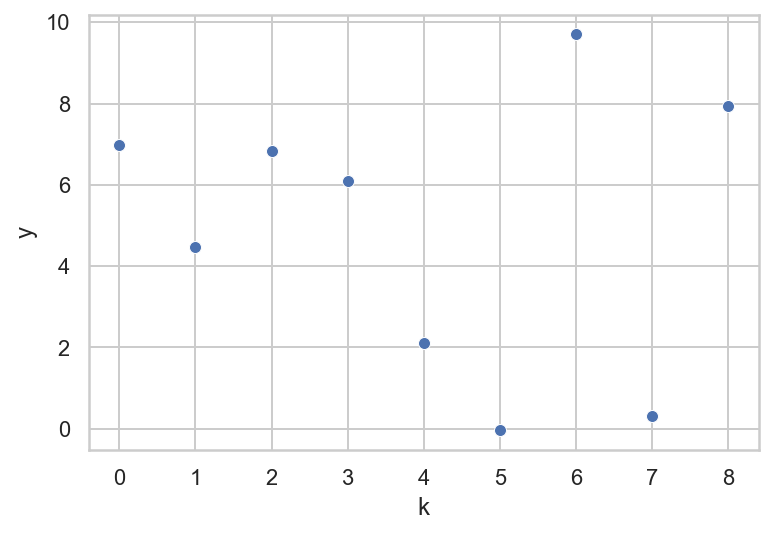

In [26]:
df = pd.DataFrame({"y": data.y, "k": data.idx.astype(str)})
sns.scatterplot(data=df, x="k", y="y")

#### Monolithically centered parameterization

Again, we will first fit a model with all of the individual parameters using the centered parameterization.
With the more informative individual likelihoods, we expect this model to perform well.

In [27]:
cp_trace, cp_y_post_pred = centered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [theta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 59 seconds.


There are no divergences and the BFMI values are near 1 for every chain.

In [28]:
az.bfmi(cp_trace)

array([1.00906872, 1.01734121, 1.02140572, 1.02789628])

The traces look great and the posterior distributions for the population parameters are very smooth.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

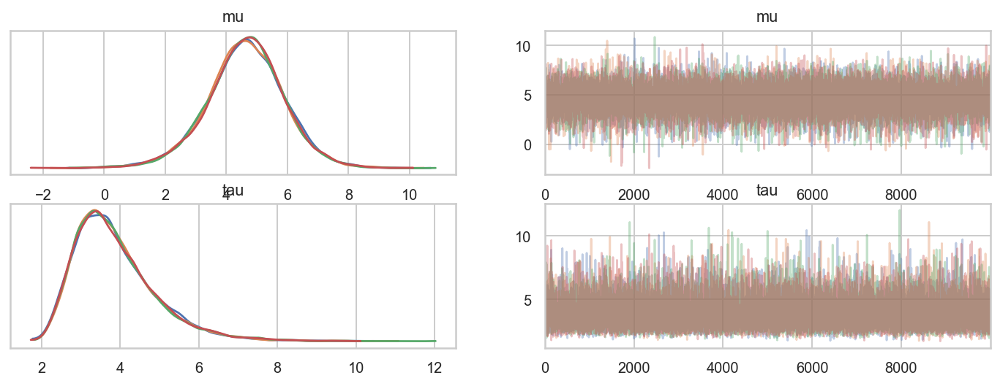

In [29]:
az.plot_trace(cp_trace, ["mu", "tau"], compact=False, combined=False)

Lastly, there are no funnels to be seen.
Instead, the distributions are very tight because of the small values of $\sigma$.

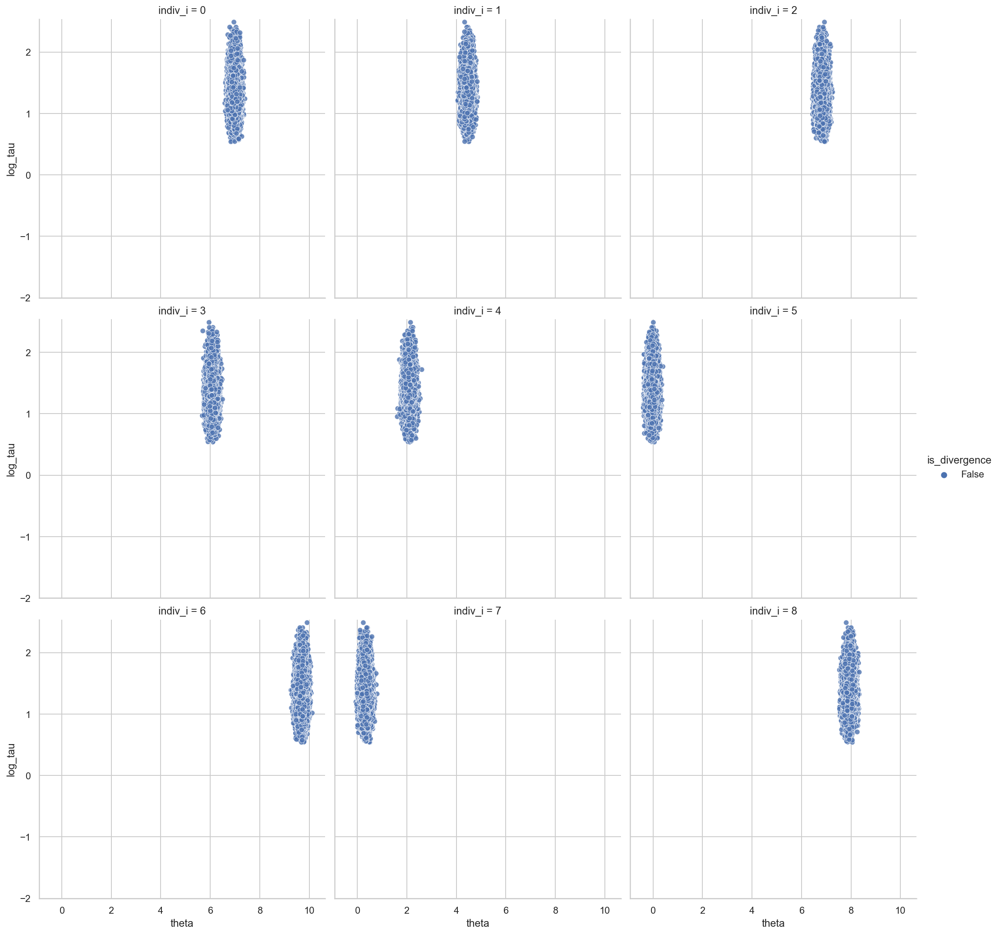

In [30]:
theta_tau_post_df = get_dispersion_and_individual_posteriors_tidy(
    cp_trace, "tau", "theta", data.K
)

plot_funnels(theta_tau_post_df, min_y=-2)

#### Monolithically non-centered parameterization

Next, model the same data with the same small $\sigma$ with a non-centered parameterization.
Because of the strongly-informed individual likelihoods, we expect to see an inverted funnel relationship between the population dispersion and individual centrality $\eta$ (the parameter used to re-parameterize $\theta$).

In [31]:
ncp_trace, ncp_y_post_pred = noncentered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [eta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 215 seconds.
The number of effective samples is smaller than 10% for some parameters.


The BFMI is lower than the centered parameterization, but not worryingly low.

In [32]:
az.bfmi(cp_trace), az.bfmi(ncp_trace)

(array([1.00906872, 1.01734121, 1.02140572, 1.02789628]),
 array([0.77967668, 0.79855242, 0.77070893, 0.78978142]))

As you can see reported by the model fitting process, it took much longer to sample from the posterior with the non-centered parameterization than with the centered parameterization.
This is because the non-centered model had to take much smaller step-sizes to resolve the posterior density function.

In [33]:
def get_avg_chain_step_size(t: az.InferenceData) -> np.ndarray:
    return t.sample_stats.step_size.values.mean(axis=1)


get_avg_chain_step_size(cp_trace), get_avg_chain_step_size(ncp_trace)

(array([0.47424311, 0.4113475 , 0.44130387, 0.36984968]),
 array([0.01987356, 0.01842983, 0.02073512, 0.01579512]))

The trace plots for the population parameters are not as well-shaped as with the centered models, resulting in bumpy posterior distributions.
This is also highlighted by the increased autocorrelation in the chains of the non-centered model.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

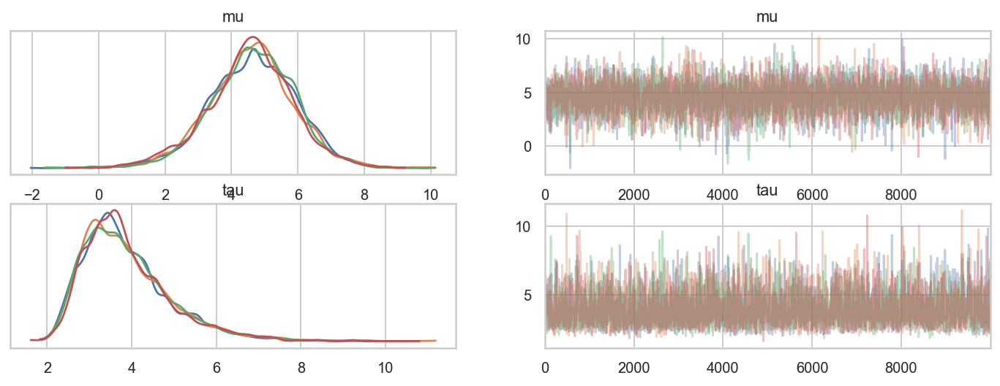

In [34]:
az.plot_trace(ncp_trace, ["mu", "tau"], compact=False, combined=False)

centered


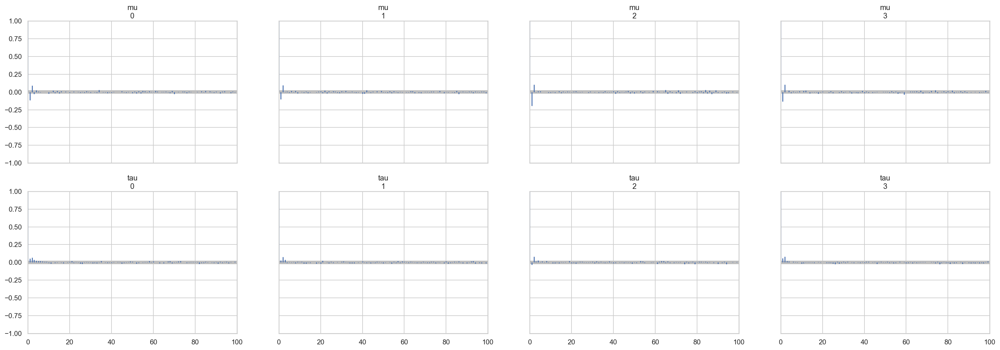

non-centered


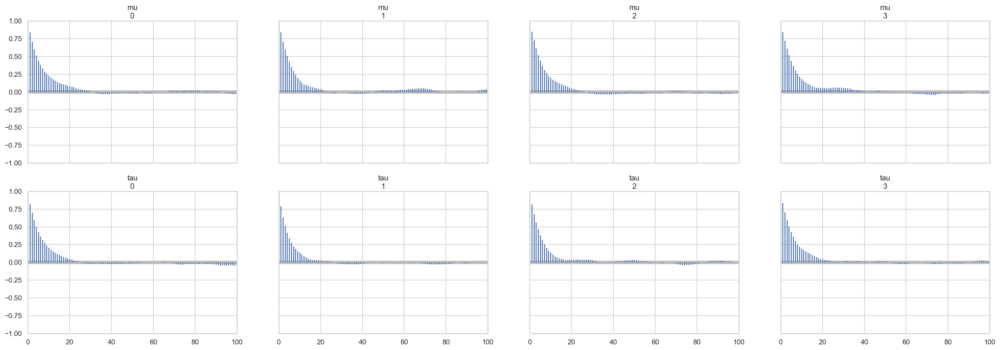

In [35]:
for t, model in zip([cp_trace, ncp_trace], ["centered", "non-centered"]):
    print(model)
    ax = az.plot_autocorr(t, var_names=["mu", "tau"])
    plt.show()

Looking at the relationship between population dispersion and individual parameters, we can see some mold inverted funnel geometry.
The shape is not as severe as in the pathological case with the centered model because here it is mitigated by partial pooling.

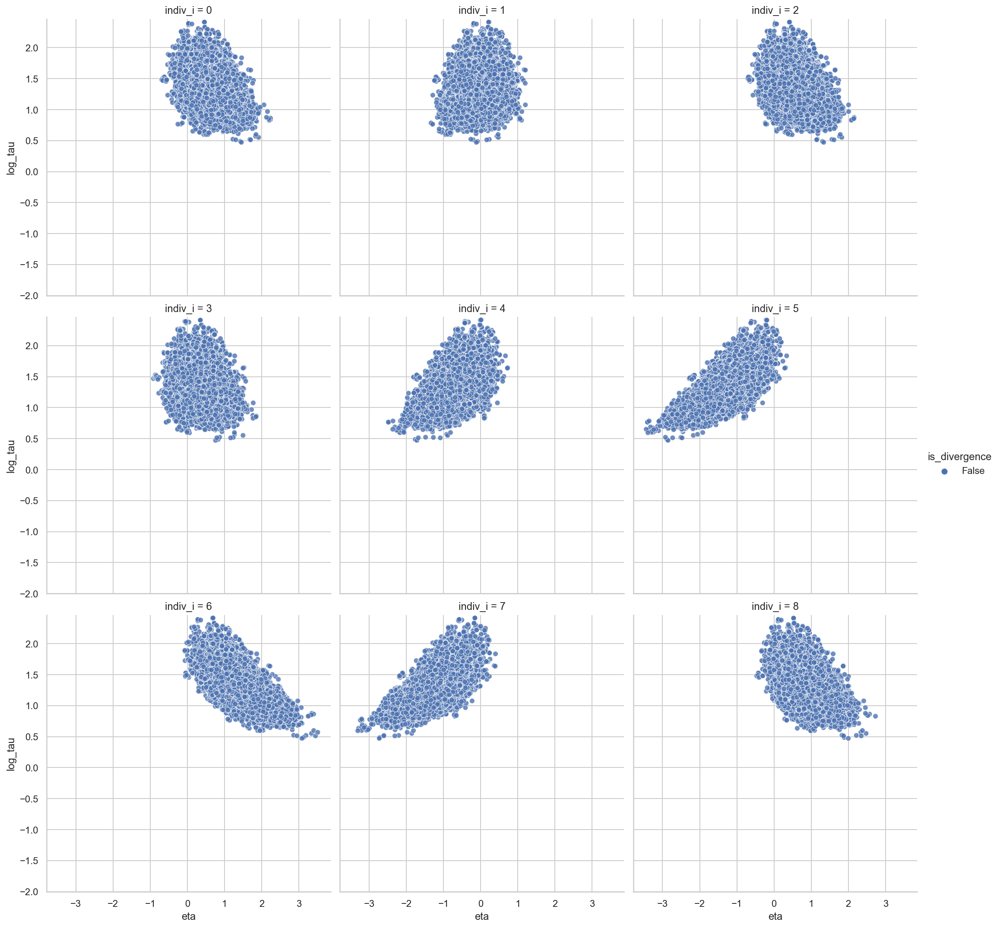

In [36]:
theta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "theta", data.K
)
eta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "eta", data.K
)
plot_funnels(eta_tau_post_df_ncp, x="eta", min_y=-2)

The partial pooling pushes the posterior away from small and large values of $\tau$, preventing the chain from venturing into the funnel.

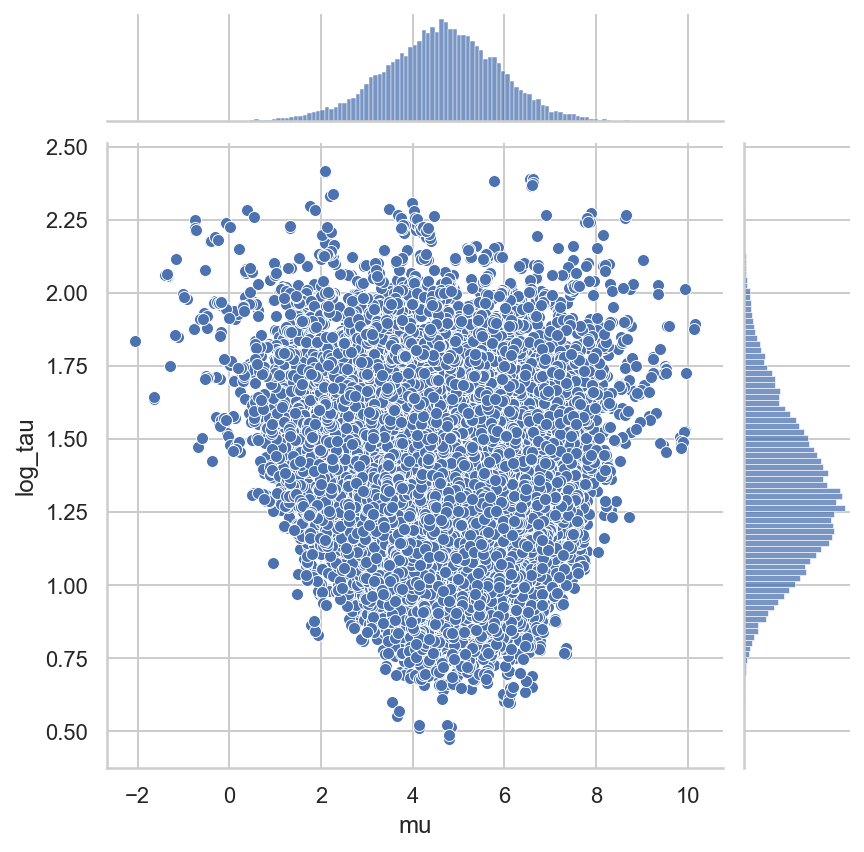

In [37]:
ncp_population_post = pd.DataFrame(
    {v: ncp_trace.posterior[v].values.flatten() for v in ["mu", "tau"]}
).assign(log_tau=lambda d: np.log(d.tau))
sns.jointplot(data=ncp_population_post, x="mu", y="log_tau")

Below is a comparison of the relationship between the population dispersion $\tau$ and individual parameters $\theta$ between the centered (blue) and non-centered (red, underneath) models.
There really isn't too much of a difference in this case, though we should still be careful because we know some of the posteriors for $\eta$ in the non-centered model demonstrated some inverted-funnel geometry.

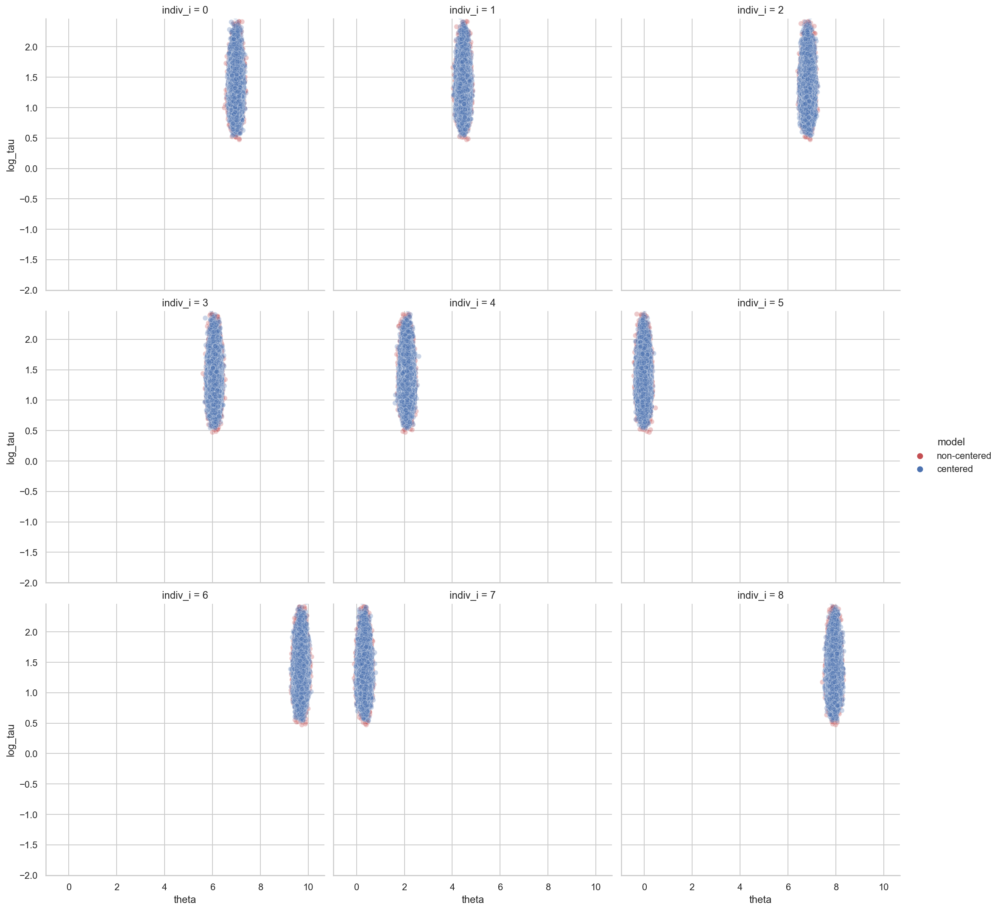

In [38]:
plot_overlapping_funnels(theta_tau_post_df, theta_tau_post_df_ncp, min_y=-2)

The posteriors for $\tau$ are also almost identical and quite accurate.

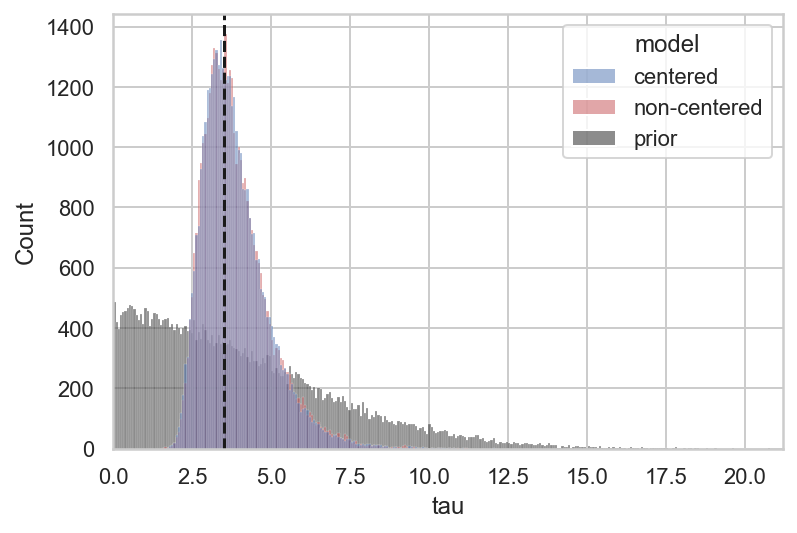

In [39]:
plot_prior_against_tau_post(cp_trace, ncp_trace, data.tau)

Finally, the posterior predictive check for both models indcates they both fit the data well.

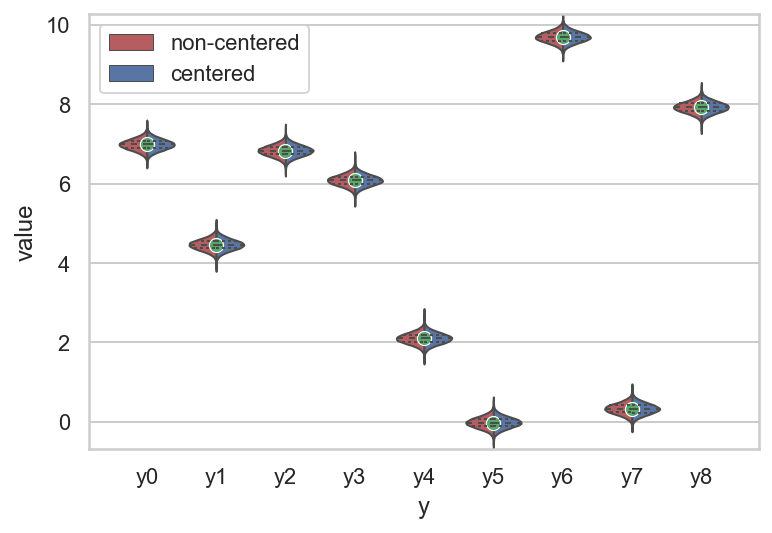

In [40]:
plot_comparison_ppc(cp_y_post_pred, ncp_y_post_pred, data)

### Unbalanced Likelihood Functions

Finally, we will reproduce a common circumstance where some individual cases have more data than others, thus some individual likelihood functions are highly informed and others are not.
In the data below, individuals $k=2$ and $k=6$ are strongly informed compared to the others.
From the demonstrations above, we would think that the centered parameterization would be referred for the well-informed cases, but the non-centered parameterization would be better for the weakly-informed cases.
We will see that a model that mixes these parameterizations is superior to the implementation of either one or the other.

In [41]:
K = 9
N_per_indiv = (10, 5, 1000, 10, 1, 5, 100, 10, 5)
indiv_idx = np.hstack([np.repeat(i, n) for i, n in enumerate(N_per_indiv)]).flatten()
N = indiv_idx.shape[0]
sigma = 10

np.random.seed(RANDOM_SEED)
data = generate_data(N=N, K=K, indiv_idx=indiv_idx, sigma=sigma)

<AxesSubplot:xlabel='idx', ylabel='y'>

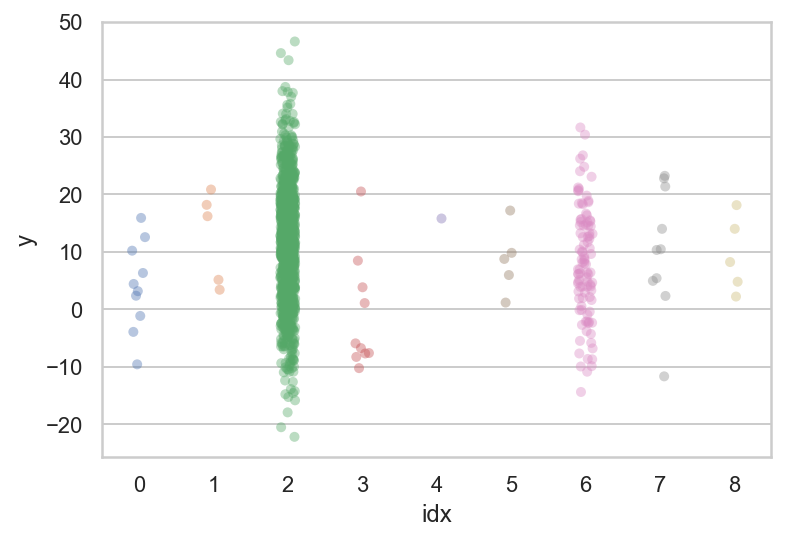

In [42]:
df = pd.DataFrame({"idx": data.idx, "y": data.y})
sns.stripplot(data=df, x="idx", y="y", alpha=0.4, dodge=True)

#### Monolithically centered parameterization

First, we will fit a model with all of the individual parameters using the centered parameterization.
Again, this parameterization should work well for the individuals with highly-informed likelihoods, but show funnel degeneracies with the weakly-informed individuals.

In [43]:
cp_trace, cp_y_post_pred = centered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [theta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 76 seconds.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 4 divergences after tuning. Increase `target_accept` or reparameterize.
There were 2 divergences after tuning. Increase `target_accept` or reparameterize.


The BFMI is lower than when all cases are uniformly well-informed, but it is not at problematic levels, yet.

In [44]:
az.bfmi(cp_trace)

array([0.82292475, 0.78691209, 0.79061772, 0.79905284])

Overall, the posteriors for the population parameters look smooth, but there are some troubling divergences.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

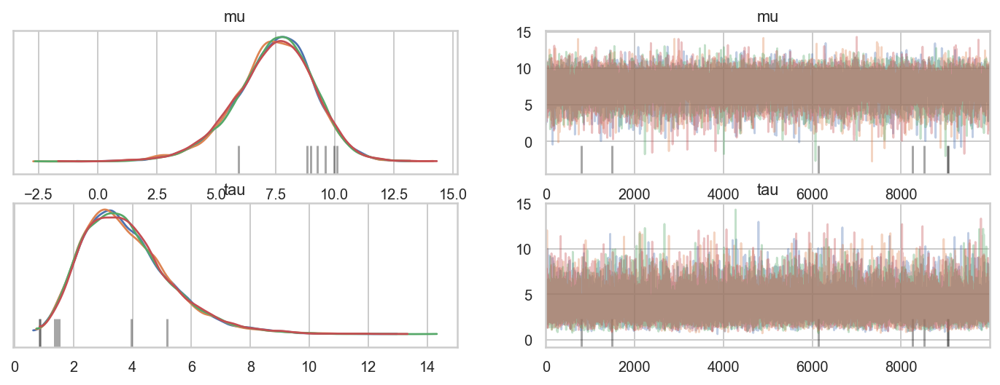

In [45]:
az.plot_trace(cp_trace, ["mu", "tau"], compact=False, combined=False)

We can see that these divergences occur within the funnels of the weakly-informed individuals.

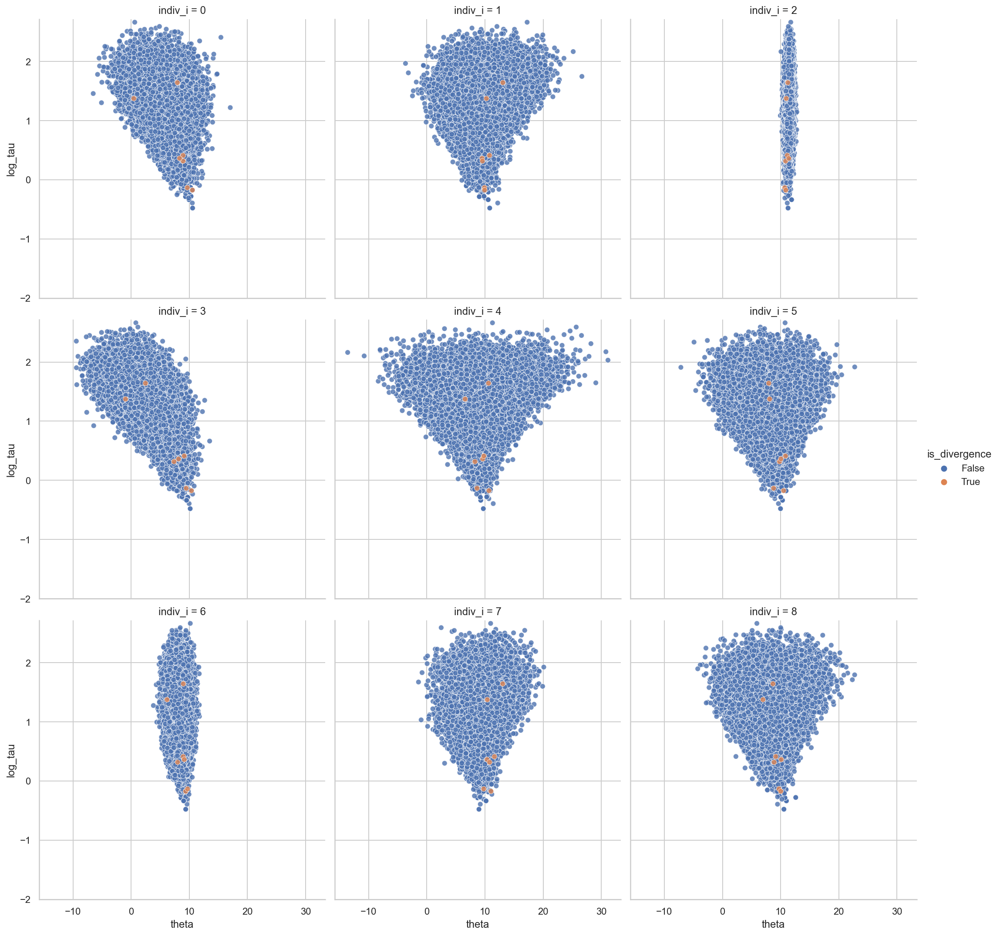

In [46]:
theta_tau_post_df = get_dispersion_and_individual_posteriors_tidy(
    cp_trace, "tau", "theta", data.K
)

plot_funnels(theta_tau_post_df, min_y=-2)

#### Monolithically non-centered parameterization

For the non-centered parameterization, we expect good results for the weakly-informed individuals, but the strongly-informed cases may show some inverted-funnel geometry.

In [47]:
ncp_trace, ncp_y_post_pred = noncentered_model(data)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [eta, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 140 seconds.
There were 5 divergences after tuning. Increase `target_accept` or reparameterize.
There were 52 divergences after tuning. Increase `target_accept` or reparameterize.
There were 6 divergences after tuning. Increase `target_accept` or reparameterize.
The number of effective samples is smaller than 25% for some parameters.


Interestingly, the BFMI values are very similar to those from the centered model.

In [48]:
az.bfmi(cp_trace), az.bfmi(ncp_trace)

(array([0.82292475, 0.78691209, 0.79061772, 0.79905284]),
 array([0.82203688, 0.76877157, 0.82042667, 0.85118955]))

There are a lot of divergences here, primarily at the extremes of the population parameters.
In particular, most of the divergences are at high values of the population dispersion $\tau$ which represents the top of the inverted funnel.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

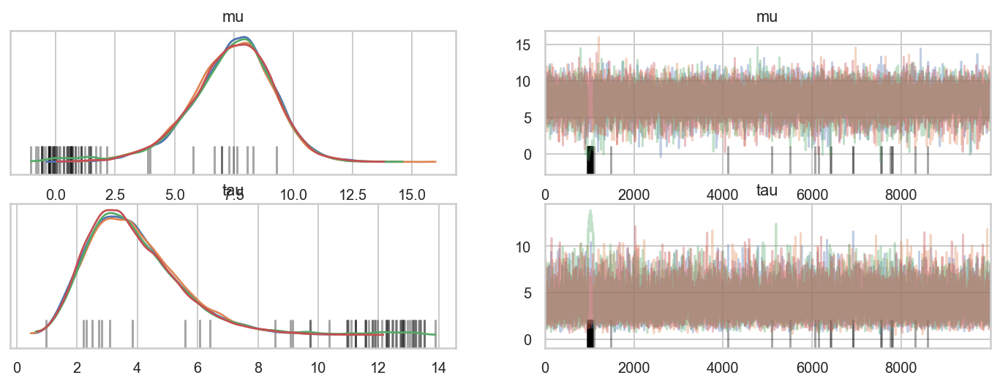

In [49]:
az.plot_trace(ncp_trace, ["mu", "tau"], compact=False, combined=False)

We can see some inverted funnel geometries in the plot below, particularly for the strongly-informed individual distributions $k=2$ and $k=6$.
Note that the divergent steps (orange) are right at the tip of the inverted funnels.

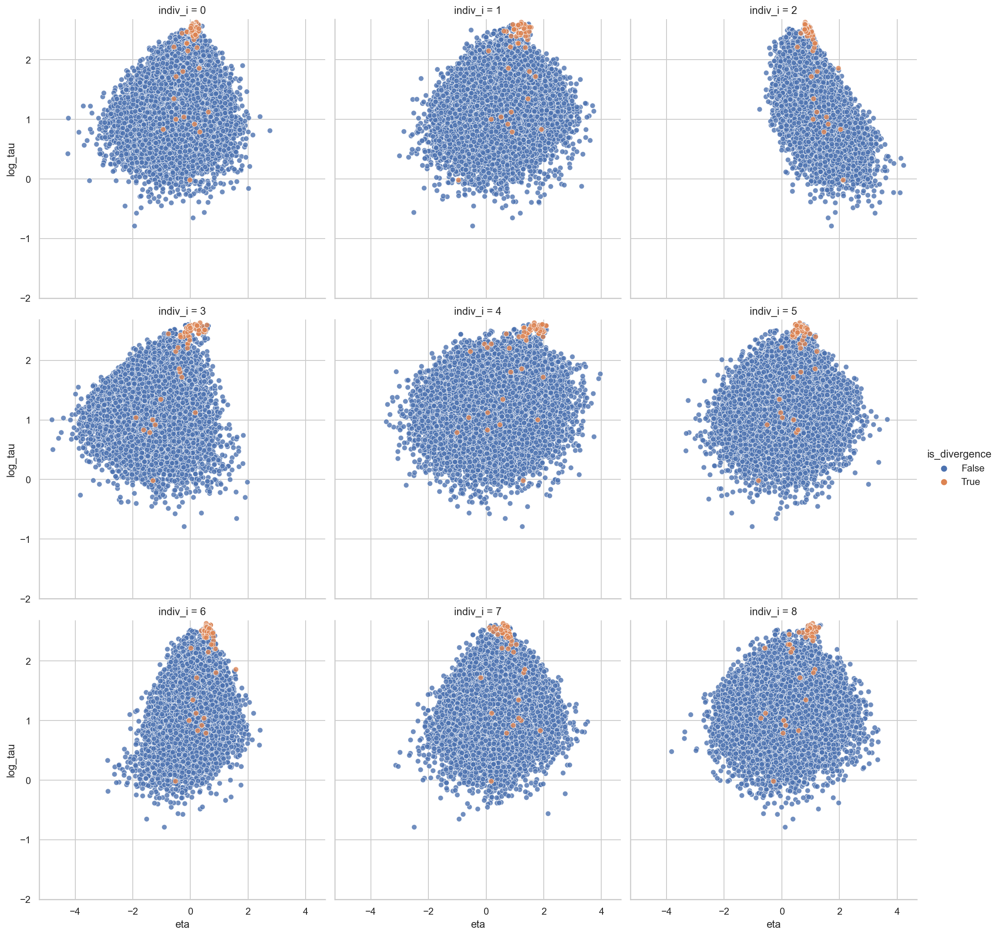

In [50]:
theta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "theta", data.K
)

eta_tau_post_df_ncp = get_dispersion_and_individual_posteriors_tidy(
    ncp_trace, "tau", "eta", data.K
)
plot_funnels(eta_tau_post_df_ncp, x="eta", min_y=-2)

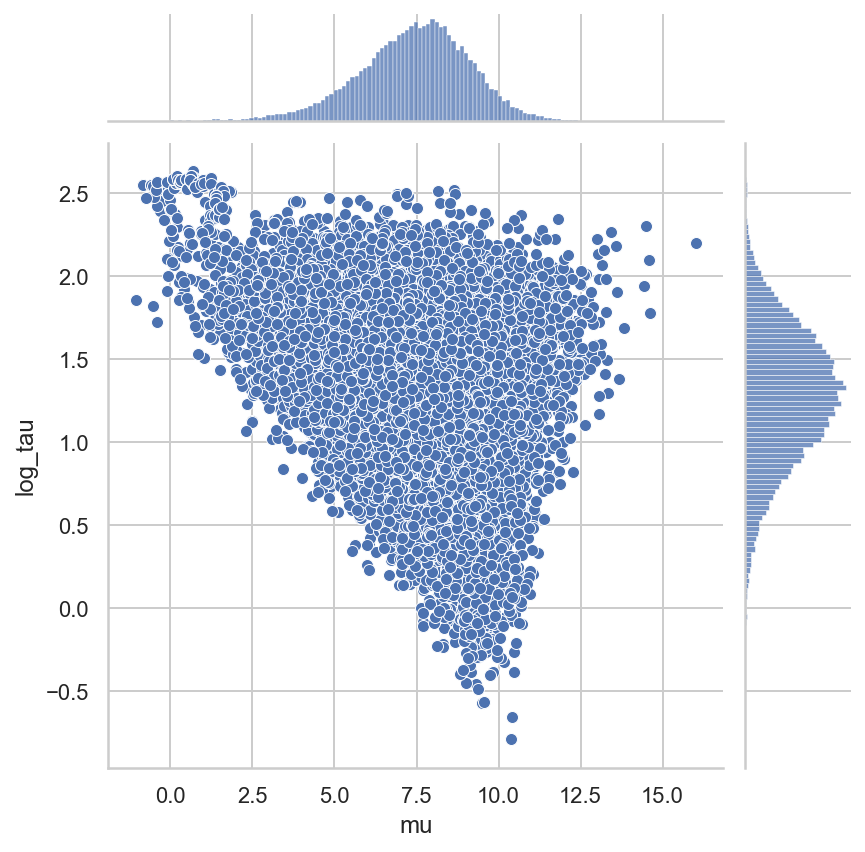

In [51]:
ncp_population_post = pd.DataFrame(
    {v: ncp_trace.posterior[v].values.flatten() for v in ["mu", "tau"]}
).assign(log_tau=lambda d: np.log(d.tau))
sns.jointplot(data=ncp_population_post, x="mu", y="log_tau")

The distributions of the population dispersion $\tau$ and individual parameter $\theta$ are very similar between the two models.

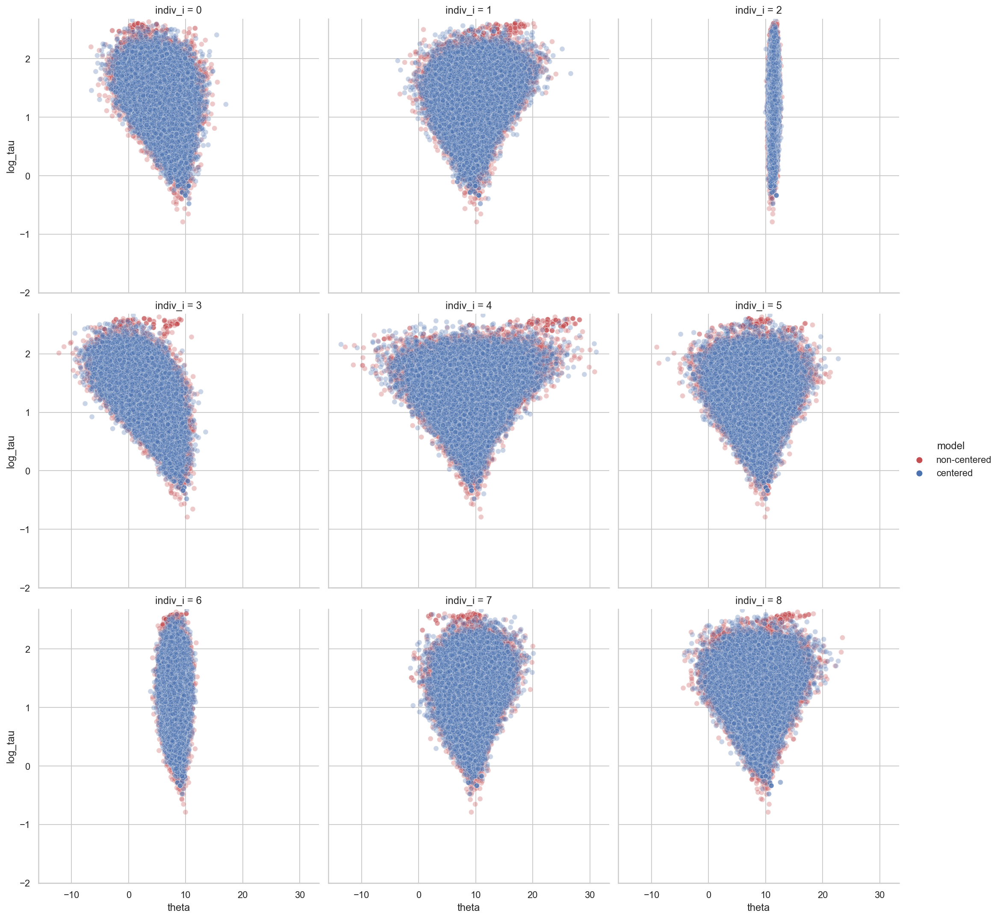

In [52]:
plot_overlapping_funnels(theta_tau_post_df, theta_tau_post_df_ncp, min_y=-2)

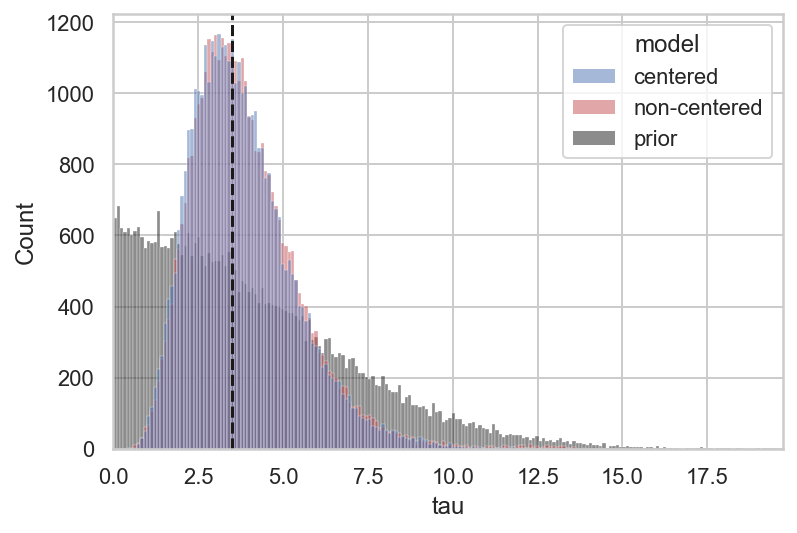

In [53]:
plot_prior_against_tau_post(cp_trace, ncp_trace, data.tau)

#### Mixed centered and non-centered parameterization

Finally, we can build a model with a mixture of centered and non-centered parameterizations.

The way I did this is relatively simple and based off of the Stan code Betancourt wrote.
I made separate $\theta$ variables for the centered and noncentered parameterizations, `theta_cp` and `theta_ncp` (along with the $\eta$ variable for the non-centered parameterization `eta_ncp`), where the size of each is the number of parameters to parameterize with the method (e.g. `theta_cp` is of size 2 in this case for the strongly-informed individuals).
Then, I created a temporary list object `_theta` of length `K` with arbitrary values as placeholders.
Then, for each individual's index, I replaced the placeholder in the list with the appropriate values from either `theta_cp` or `theta_ncp`.
The elements of the list were then concatenated into the model variable `theta` and indexed like normal in the model's likelihood.

In [54]:
def mixed_parameterization(
    d: MockData,
    cp_idx: np.ndarray,
    ncp_idx: np.ndarray,
    draws: int = 10000,
    tune: int = 1000,
) -> tuple[pm.Model, az.InferenceData, dict[str, np.ndarray]]:
    n_cp = len(np.unique(cp_idx))
    n_ncp = len(np.unique(ncp_idx))
    with pm.Model() as mixp_model:
        mu = pm.Normal("mu", 0, 5)
        tau = pm.HalfNormal("tau", 5)

        theta_cp = pm.Normal("theta_cp", mu, tau, shape=n_cp)
        eta_ncp = pm.Normal("eta_ncp", 0, 1, shape=n_ncp)
        theta_ncp = pm.Deterministic("theta_ncp", mu + tau * eta_ncp)

        _theta = list(range(d.K))
        for i, t in enumerate(cp_idx):
            _theta[t] = theta_cp[i]
        for i, t in enumerate(ncp_idx):
            _theta[t] = theta_ncp[i]

        theta = pm.Deterministic("theta", pm.math.stack(_theta))

        y = pm.Normal("y", theta[d.idx], d.sigma, observed=d.y)

        trace = pm.sample(
            draws=draws,
            tune=tune,
            chains=4,
            cores=4,
            return_inferencedata=True,
            random_seed=RANDOM_SEED,
            target_accept=0.95,
        )
        assert isinstance(trace, az.InferenceData)
        y_post_pred = pm.sample_posterior_predictive(
            trace=trace, random_seed=RANDOM_SEED
        )
    return mixp_model, trace, y_post_pred

In [55]:
cp_idx = np.array([2, 6])
ncp_idx = np.array([0, 1, 3, 4, 5, 7, 8])

mixp_model, mixp_trace, mixp_post_pred = mixed_parameterization(
    data, cp_idx=cp_idx, ncp_idx=ncp_idx
)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [eta_ncp, theta_cp, tau, mu]


Sampling 4 chains for 1_000 tune and 10_000 draw iterations (4_000 + 40_000 draws total) took 87 seconds.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There were 3 divergences after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.
There was 1 divergence after tuning. Increase `target_accept` or reparameterize.


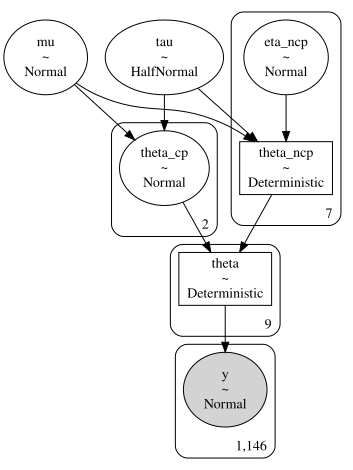

In [56]:
pm.model_to_graphviz(mixp_model)

While there were a few divergences, the BFMI is higher in every chain in the mixed-parameterization model than either the centered or non-centered only models.

In [57]:
az.bfmi(cp_trace), az.bfmi(ncp_trace), az.bfmi(mixp_trace)

(array([0.82292475, 0.78691209, 0.79061772, 0.79905284]),
 array([0.82203688, 0.76877157, 0.82042667, 0.85118955]),
 array([0.96895774, 0.98508927, 0.96039783, 0.96455833]))

Also, the trace plots looks fine to me.

array([[<AxesSubplot:title={'center':'mu'}>,
        <AxesSubplot:title={'center':'mu'}>],
       [<AxesSubplot:title={'center':'tau'}>,
        <AxesSubplot:title={'center':'tau'}>]], dtype=object)

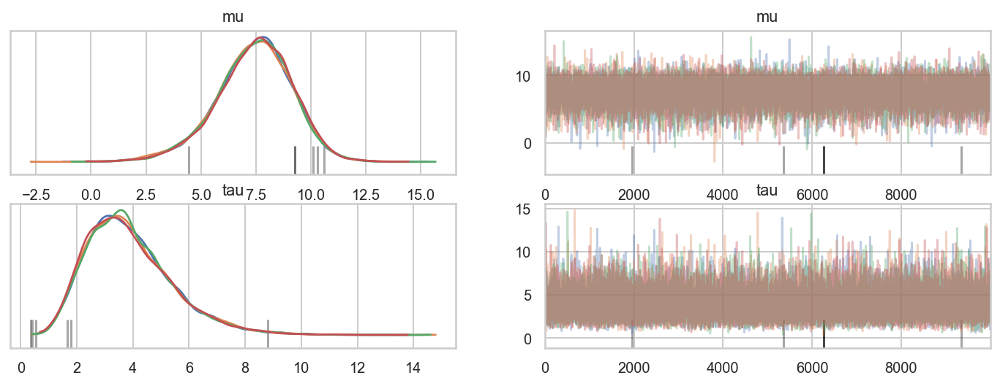

In [58]:
az.plot_trace(mixp_trace, ["mu", "tau"], compact=False, combined=False)

Lastly, the step sizes are back to the large and fast steps of the centered parameterization.

In [59]:
get_avg_chain_step_size(cp_trace), get_avg_chain_step_size(
    ncp_trace
), get_avg_chain_step_size(mixp_trace)

(array([0.31539328, 0.20825967, 0.25216215, 0.25867726]),
 array([0.09312951, 0.10050677, 0.10491216, 0.10222326]),
 array([0.38684461, 0.37581854, 0.38238086, 0.34139381]))

We can now check for funnel geometries.
First, the individuals with the centered parameterization look very good, no funnels to be seen.

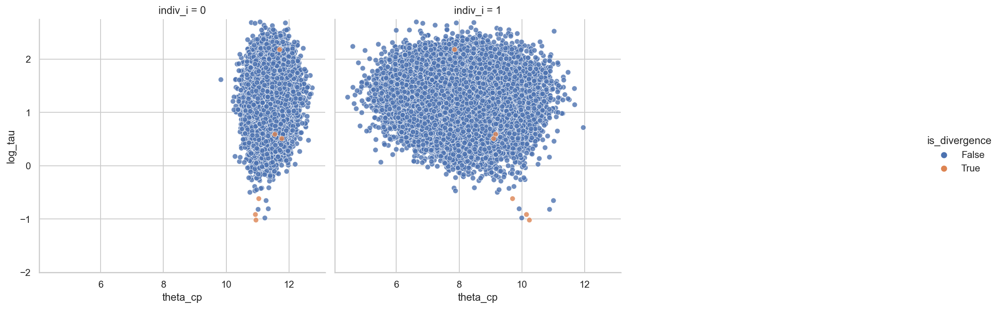

In [60]:
theta_cp_tau_post_df_mixp = get_dispersion_and_individual_posteriors_tidy(
    mixp_trace, "tau", "theta_cp", len(cp_idx)
)

plot_funnels(theta_cp_tau_post_df_mixp, "theta_cp", min_y=-2)

For the non-centered parameterized individuals, there is some mild inverted funnels in some of the cases, but it is overall preferable than before.

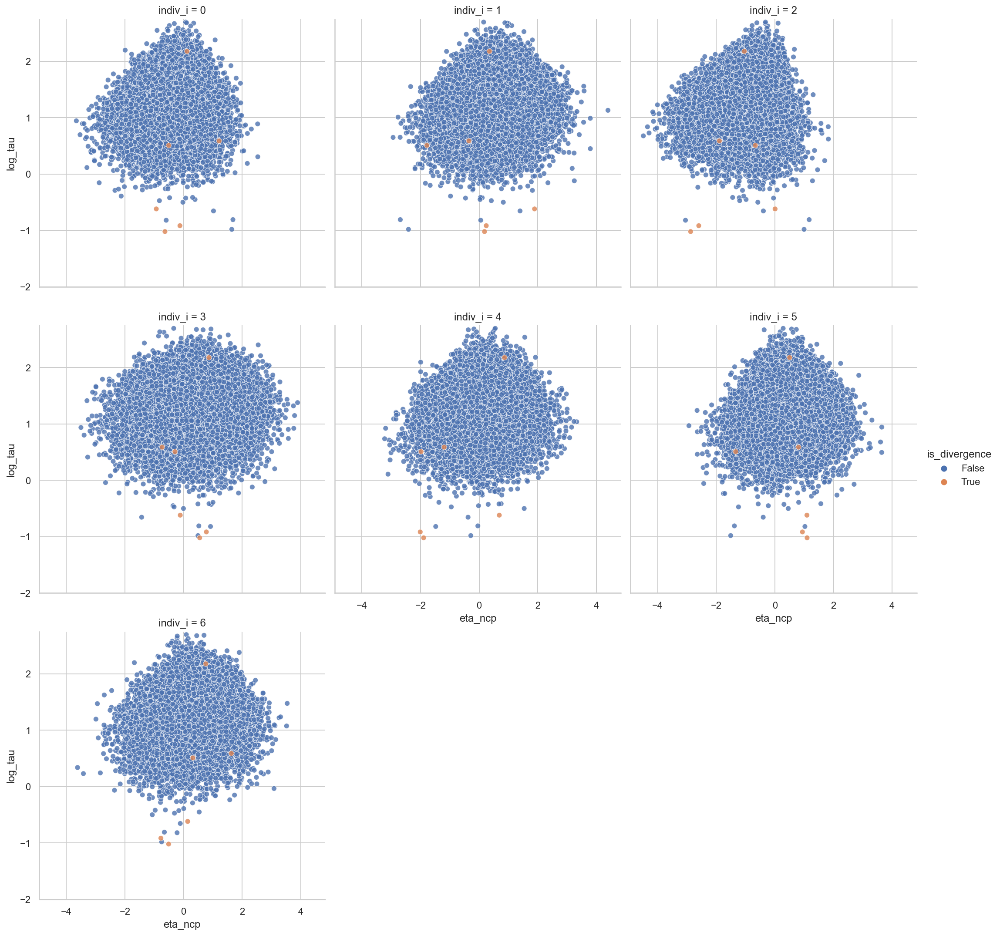

In [61]:
eta_tau_post_df_mixp = get_dispersion_and_individual_posteriors_tidy(
    mixp_trace, "tau", "eta_ncp", len(ncp_idx)
)

plot_funnels(eta_tau_post_df_mixp, "eta_ncp", min_y=-2)

In [62]:
def make_population_post_df(t: az.InferenceData) -> pd.DataFrame:
    return pd.DataFrame(
        {v: t.posterior[v].values.flatten() for v in ["mu", "tau"]}
    ).assign(log_tau=lambda d: np.log(d.tau))

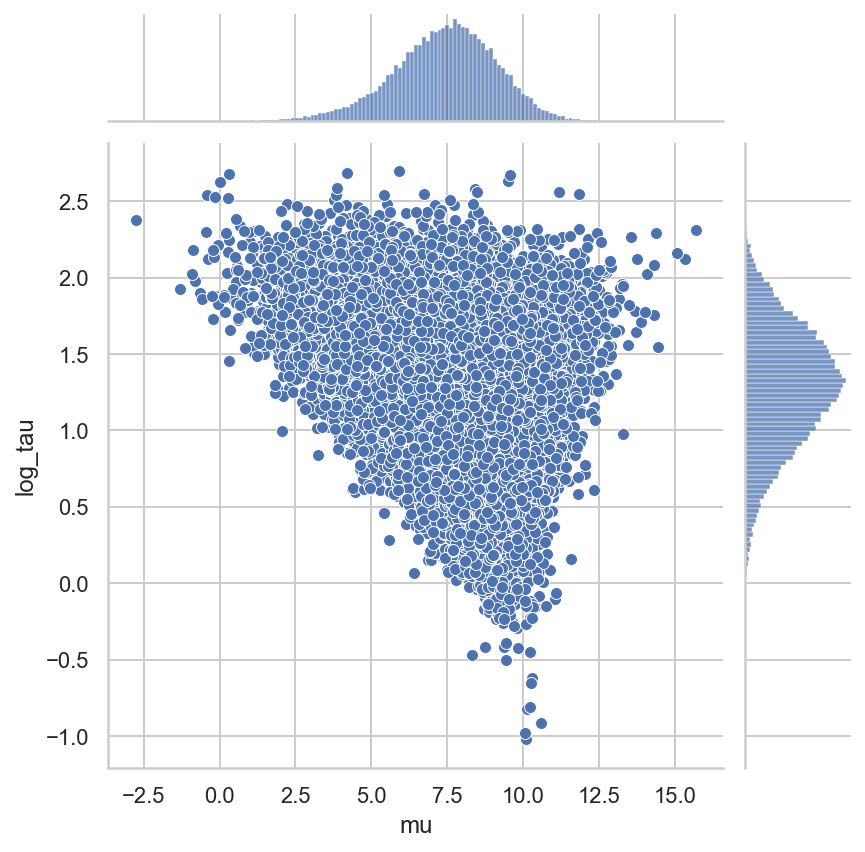

In [63]:
mixp_population_post = make_population_post_df(mixp_trace)
sns.jointplot(data=mixp_population_post, x="mu", y="log_tau")

The following plot shows the relationship between the population dispersion $\tau$ adn centrality $\mu$ for the centered (left), non-centered (middle), and mixed (right) parameterizations.
We can see that the exploration of lower values of $\tau$ was more successful in the non-centered and mixed parameterizations than in the centered model. 

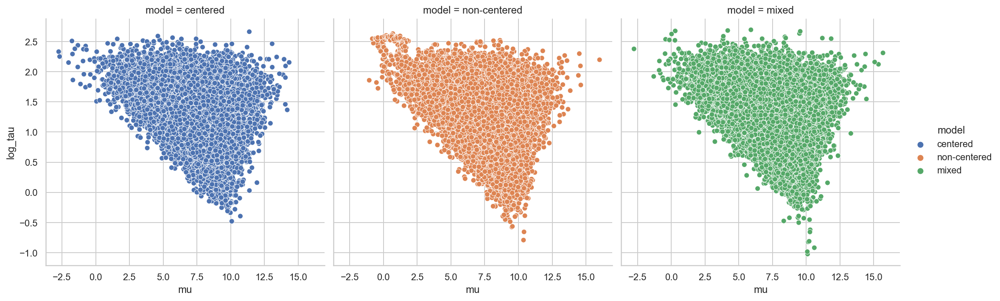

In [64]:
pop_post_df = pd.concat(
    [
        make_population_post_df(t).assign(model=m)
        for m, t in zip(
            ("centered", "non-centered", "mixed"), (cp_trace, ncp_trace, mixp_trace)
        )
    ]
)

sns.relplot(data=pop_post_df, x="mu", y="log_tau", hue="model", col="model")

## Conclusions

Hierarchical models are incredibly powerful while remaining interpretable with respect to the data being modeled and the data-generation process.
Betancourt's post was incredibly insightful and should serve as a guide to diagnosing and checking these types of models.
I have only replicated the examples that Betancourt presented and briefly included some instruction and discussion, but much more theory is available in the original post.

---

In [65]:
%load_ext watermark
%watermark -d -u -v -iv -b -h -m

Last updated: 2021-12-08

Python implementation: CPython
Python version       : 3.9.7
IPython version      : 7.30.1

Compiler    : Clang 11.1.0 
OS          : Darwin
Release     : 20.6.0
Machine     : x86_64
Processor   : i386
CPU cores   : 4
Architecture: 64bit

Hostname: JHCookMac

Git branch: refactor-stan

pymc3     : 3.11.4
numpy     : 1.21.4
pandas    : 1.3.4
seaborn   : 0.11.2
sys       : 3.9.7 | packaged by conda-forge | (default, Sep 29 2021, 20:33:18) 
[Clang 11.1.0 ]
arviz     : 0.11.4
janitor   : 0.22.0
matplotlib: 3.5.0

